<a href="https://colab.research.google.com/github/khangnkv/UniversityProjects/blob/main/des431s22_finalize_PCA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Background

PISA (https://www.oecd.org/pisa/) is a student assessment program conducted every three years by OECD to measure 15-year-old persons' ability on their mathematics, science, and reading literacy.

**How to conduct the test**

- Approximately 5,000 students were sampled from the entire 15-year-old population.

- Each person is randomly assigned 0, 1 or 2 clusters of the mathematics problems. However, there is no information related to the assignment.

# Submission

**Deadline: Feb 12, 2023; 23:59**

1. one Python notebook (.ipynb) for preprocessing and visualizing the data

2. one PDF file for the presentation


# Tasks

This project is counted 15% of your final grade. Unless stated otherwise in
your presentation, all members will receive the same score. You have to do
all the following tasks to complete the assignment.

1. Form a team of 4 members.

2. One member submits the list of team members in Google Classroom by **Jan 31, 2023; 23:59**.

3. Wait for the country assignment. You must only the country that is assigned to
your team. Otherwise, your team will receive 0 point for this assignment.

4. Load the PISA 2018 data of **the country assigned to your team** from https://github.com/cholwich/des431project1

5. Propose and implement preprocess steps so that if a student is assigned to at least 1 cluster, that student should be represented as a data point.

6. Propose and implement an application of dimensionalty reduction/data visualization techniques to visualize the preprocess data. The goal of the visualization is to understand how students performed in the PISA 2018 test.

7. Prepare slides for a 10-minute presentation to explain:

  - Steps to prepare the assigned data and the reason behind it.

  - Techniques to visualize the assigned data and the reason behind it.

  - Interesting points related to students' performance found from the visualization and the reason behind it. For example, Thai students' performance in the problems that require *formulating situations mathematically* process is worse than the other two processes.

8. Submit all required documents by **Feb 12, 2023; 23:59**. Late submission will not be accepted and will be marked 0. Do not wait until the last minute.

  **Anything that can go wrong will go wrong.** -- Murphy's law

Plagiarism and code duplication will be checked. If there is 60% similarity between your
code/presentation and other teams, your team will receive 0 point for this
assignment.

9. Present your work on the assigned date (either Feb 13 or Feb 20) within 10 minutes. To be fair to every team, you are only allowed use the submitted slides in the presentation. Exceeding 10 minutes will be subject to point deduction.

# Loading the data

In [ ]:
!curl -o /content/pisa2018_math_items.csv https://raw.githubusercontent.com/cholwich/des431project1/main/pisa2018_math_items.csv
!curl -o /content/pisa2018_math_nzl.csv https://raw.githubusercontent.com/cholwich/des431project1/main/pisa2018_math_nzl.csv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 13254  100 13254    0     0   431k      0 --:--:-- --:--:-- --:--:--  431k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1820k  100 1820k    0     0  8709k      0 --:--:-- --:--:-- --:--:-- 8709k


In [ ]:
import pandas as pd
df = pd.read_csv('/content/pisa2018_math_items.csv')

In [ ]:
# Information related to math items
import pandas as pd
items = pd.read_csv('/content/pisa2018_math_items.csv')
items

,Score Column,Time Column,Unit Name,Cluster,Sequence in Cluster,Sequence in Unit,Item Format,Content,Situation/Context,Process
0,CM033Q01S,CM033Q01T,A View Room,M01,1,1/1,Simple Multiple Choice - Computer Scored,Space and Shape,Personal,"Interpreting, Applying and Evaluating Mathemat..."
1,CM474Q01S,CM474Q01T,Running Time,M01,2,1/1,Simple Multiple Choice - Computer Scored,Quantity,Personal,"Employing Mathematical Concepts, Facts and Pro..."
2,DM155Q02C,CM155Q02T,Population Pyramids,M01,3,1/4,Open Response - Human Coded,Change and Relationships,Scientific,"Interpreting, Applying and Evaluating Mathemat..."
3,CM155Q01S,CM155Q01T,Population Pyramids,M01,4,2/4,Complex Multiple Choice - Computer Scored,Change and Relationships,Scientific,"Employing Mathematical Concepts, Facts and Pro..."
4,DM155Q03C,CM155Q03T,Population Pyramids,M01,5,3/4,Open Response - Human Coded,Change and Relationships,Scientific,"Employing Mathematical Concepts, Facts and Pro..."
...,...,...,...,...,...,...,...,...,...,...
77,DM961Q05C,CM961Q05T,Chocolate,M6B,8,3/3,Open Response - Human Coded,Uncertainty and Data,Occupational,"Interpreting, Applying and Evaluating Mathemat..."
78,CM939Q01S,CM939Q01T,Racing,M6B,9,1/2,Simple Multiple Choice - Computer Scored,Uncertainty and Data,Societal,"Interpreting, Applying and Evaluating Mathemat..."
79,CM939Q02S,CM939Q02T,Racing,M6B,10,2/2,Simple Multiple Choice - Computer Scored,Uncertainty and Data,Societal,"Interpreting, Applying and Evaluating Mathemat..."
80,CM967Q01S,CM967Q01T,Wooden Train Set,M6B,11,1/2,Open Response - Computer Scored,Space and Shape,Personal,"Employing Mathematical Concepts, Facts and Pro..."


In [ ]:
# Students' score and time
df = pd.read_csv('/content/pisa2018_math_nzl.csv')
df

In [ ]:
df.head()

,CNT,CNTSCHID,CNTSTUID,CM033Q01T,CM474Q01T,CM155Q02T,CM155Q01T,CM155Q03T,CM155Q04T,CM411Q01T,...,CM948Q03S,CM936Q01S,DM936Q02C,DM961Q02C,CM961Q03S,DM961Q05C,CM939Q01S,CM939Q02S,CM967Q01S,CM967Q03S
0,NZL,55400104,55400001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NZL,55400142,55400003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NZL,55400156,55400004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NZL,55400007,55400005,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NZL,55400105,55400006,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.tail()

,CNT,CNTSCHID,CNTSTUID,CM033Q01T,CM474Q01T,CM155Q02T,CM155Q01T,CM155Q03T,CM155Q04T,CM411Q01T,...,CM948Q03S,CM936Q01S,DM936Q02C,DM961Q02C,CM961Q03S,DM961Q05C,CM939Q01S,CM939Q02S,CM967Q01S,CM967Q03S
6168,NZL,55400142,55408167,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6169,NZL,55400045,55408168,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6170,NZL,55400150,55408170,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6171,NZL,55400146,55408172,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6172,NZL,55400139,55408174,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.dtypes

CNT           object
CNTSCHID       int64
CNTSTUID       int64
CM033Q01T    float64
CM474Q01T    float64
              ...   
DM961Q05C    float64
CM939Q01S    float64
CM939Q02S    float64
CM967Q01S    float64
CM967Q03S    float64
Length: 167, dtype: object

In [ ]:
X = df.iloc[:,1]
Y = df.iloc[:,9]
print(X)
print(Y)

0       55400104
1       55400142
2       55400156
3       55400007
4       55400105
          ...   
6168    55400142
6169    55400045
6170    55400150
6171    55400146
6172    55400139
Name: CNTSCHID, Length: 6173, dtype: int64
0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
6168   NaN
6169   NaN
6170   NaN
6171   NaN
6172   NaN
Name: CM411Q01T, Length: 6173, dtype: float64


In [ ]:
X = df.iloc[:,1]
Y = df.iloc[:,9]
print(X)
print(Y)

0       55400104
1       55400142
2       55400156
3       55400007
4       55400105
          ...   
6168    55400142
6169    55400045
6170    55400150
6171    55400146
6172    55400139
Name: CNTSCHID, Length: 6173, dtype: int64
0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
6168   NaN
6169   NaN
6170   NaN
6171   NaN
6172   NaN
Name: CM411Q01T, Length: 6173, dtype: float64


In [ ]:
X.head()

0    55400104
1    55400142
2    55400156
3    55400007
4    55400105
Name: CNTSCHID, dtype: int64

## Note 1:

If a student has a non-null value in a time column, we assume that the student was assigned to the cluster containing that time column.

The student should get the score of 0 even if they omit some items in the cluster.

In [ ]:
clusters = items['Cluster'].drop_duplicates().tolist()
for c in clusters:
    time_columns = items[items['Cluster'] == c]['Time Column']
    df[c] = df.loc[:, time_columns].count(axis=1)

In [ ]:
df.loc[0:10, clusters]

,M01,M02,M03,M04,M05,M6A,M6B
0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0
8,0,0,11,0,12,0,0
9,0,11,11,0,0,0,0


In [ ]:
bytime = df.loc[df['M01']+df['M02']+df['M03']+df['M04']+df['M05']+df['M6A']+df['M6B']>0,clusters]
bytime

,M01,M02,M03,M04,M05,M6A,M6B
8,0,0,11,0,12,0,0
9,0,11,11,0,0,0,0
10,0,0,0,12,12,0,0
13,0,0,0,12,12,0,0
14,0,0,0,12,12,0,0
...,...,...,...,...,...,...,...
6166,0,0,0,0,12,0,0
6167,0,0,0,12,0,12,0
6169,0,11,0,0,0,12,0
6170,0,0,0,0,12,0,0


## Note 2:

The score columns starting with 'DM' were graded by human.

- If the value is '2x', the score is 2.

- If the value is '1x', the score is 1.

- Otherwise, the score is 0.

In [ ]:
df.loc[df['DM155Q02C'] > 10, ['DM155Q02C', 'DM155Q03C']]

,DM155Q02C,DM155Q03C
28,21.0,0.0
34,21.0,NaN
53,21.0,0.0
60,21.0,13.0
73,12.0,0.0
...,...,...
6141,21.0,0.0
6142,21.0,0.0
6147,21.0,12.0
6149,12.0,22.0


In [ ]:
# Student at index 32 gets 2 and 0 points for DM155Q02C and DM155Q03C, respectively
# Student at index 44 gets 2 and 2 points for DM155Q02C and DM155Q03C, respectively
# Student at index 53 gets 1 and 0 points for DM155Q02C and DM155Q03C, respectively
# Student at index 82 gets 2 and 1 points for DM155Q02C and DM155Q03C, respectively

Dropping Duplicates for Both Math and Items Dataset

# Pre-Processing

## Preprocess by Removing NaN

In [ ]:
df.isnull().sum()

CNT             0
CNTSCHID        0
CNTSTUID        0
CM033Q01T    5173
CM474Q01T    5173
             ... 
DM961Q05C    6173
CM939Q01S    6173
CM939Q02S    6173
CM967Q01S    6173
CM967Q03S    6173
Length: 167, dtype: int64

In [ ]:
new_df = df.fillna(0)
new_df

,CNT,CNTSCHID,CNTSTUID,CM033Q01T,CM474Q01T,CM155Q02T,CM155Q01T,CM155Q03T,CM155Q04T,CM411Q01T,...,CM948Q03S,CM936Q01S,DM936Q02C,DM961Q02C,CM961Q03S,DM961Q05C,CM939Q01S,CM939Q02S,CM967Q01S,CM967Q03S
0,NZL,55400104,55400001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,NZL,55400142,55400003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,NZL,55400156,55400004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,NZL,55400007,55400005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,NZL,55400105,55400006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6168,NZL,55400142,55408167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6169,NZL,55400045,55408168,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6170,NZL,55400150,55408170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6171,NZL,55400146,55408172,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
new_df.isnull().sum()

CNT          0
CNTSCHID     0
CNTSTUID     0
CM033Q01T    0
CM474Q01T    0
            ..
DM961Q05C    0
CM939Q01S    0
CM939Q02S    0
CM967Q01S    0
CM967Q03S    0
Length: 167, dtype: int64

Dropping Duplicates for Both Math and Items Dataset

In [ ]:
new_df = new_df.drop_duplicates()
items = items.drop_duplicates()


Checking The Unique


In [ ]:
new_df.nunique()

CNT             1
CNTSCHID      192
CNTSTUID     6173
CM033Q01T     992
CM474Q01T     989
             ... 
M03             6
M04             8
M05             9
M6A             8
M6B             1
Length: 174, dtype: int64

## Preprocess each column

In [ ]:
cluster_score = items['Cluster'].drop_duplicates().tolist()
for c in cluster_score:
    score_columns = items[items['Cluster'] == c]['Score Column']
    df[c] = df.loc[:, score_columns].count(axis=1)


#We are removing the cluster that did not take the test

In [ ]:
df.loc[df['M01']+df['M02']+df['M03']+df['M04']+df['M05']+df['M6A']+df['M6B']>0,cluster_score]

,M01,M02,M03,M04,M05,M6A,M6B
8,0,0,11,0,12,0,0
9,0,11,11,0,0,0,0
10,0,0,0,12,12,0,0
13,0,0,0,12,11,0,0
14,0,0,0,11,12,0,0
...,...,...,...,...,...,...,...
6166,0,0,0,0,12,0,0
6167,0,0,0,10,0,9,0
6169,0,11,0,0,0,12,0
6170,0,0,0,0,10,0,0


## Preprocess by Human checked

Unit name: Third Side

In [ ]:
df.loc[df['DM462Q01C'] > 0, ['DM462Q01C']]

,DM462Q01C
53,1.0
60,1.0
73,1.0
77,1.0
81,1.0
...,...
6141,1.0
6142,2.0
6147,1.0
6149,1.0


Unit name: Running Tracks

In [ ]:
new_df = df.fillna(0)
new_df.loc[new_df['DM406Q01C'] > 0, ['DM406Q01C', 'DM406Q02C']]

Unit name: Thermometer Cricket

In [ ]:
new_df.loc[new_df['DM446Q02C'] > 0, ['DM446Q02C']]

,DM446Q02C
8,1.0
135,1.0
159,1.0
324,1.0
329,1.0
...,...
5926,1.0
6008,1.0
6030,1.0
6060,1.0


Unit name: Carbon Dioxide

In [ ]:
new_df.loc[new_df['DM828Q02C'] > 0, ['DM828Q02C']]

,DM828Q02C
8,1.0
16,1.0
28,1.0
50,1.0
62,1.0
...,...
6141,1.0
6143,1.0
6145,1.0
6149,1.0


Unit name: Spacers

In [ ]:
new_df.loc[new_df['DM992Q03C'] > 0, ['DM992Q03C']]

,DM992Q03C
22,1.0
70,1.0
487,1.0
543,1.0
647,1.0
...,...
5760,1.0
5791,1.0
5839,1.0
6078,1.0


Unit name: Crazy Ants

In [ ]:
new_df.loc[new_df['DM906Q02C'] > 0, ['DM906Q02C']]

,DM906Q02C
10,2.0
13,2.0
14,1.0
22,2.0
29,2.0
...,...
6090,2.0
6111,2.0
6130,2.0
6148,1.0


Unit name: Wheelchair Basketball

In [ ]:
new_df.loc[new_df['DM00KQ02C'] > 0, ['DM00KQ02C']]

,DM00KQ02C
70,1.0
166,1.0
232,1.0
370,1.0
487,1.0
...,...
5959,1.0
6020,1.0
6127,1.0
6136,1.0


Unit name: Roof Truss Design

In [ ]:
new_df.loc[new_df['DM949Q03C'] > 0, ['DM949Q03C']]

,DM949Q03C
8,2.0
10,2.0
13,2.0
22,2.0
27,2.0
...,...
6113,2.0
6116,2.0
6165,2.0
6166,2.0


# Data Cleaning(Converting our Data and Target Values)


In [ ]:
n_space = len(items[items['Content'] == 'Space and Shape'])
n_quantity = len(items[items['Content'] == 'Quantity'])
n_change = len(items[items['Content'] == 'Change and Relationships'])
n_un = len(items[items['Content'] == 'Uncertainty and Data'])

### Show numbers of Time and Scores by Content

In [ ]:
content = items['Content'].drop_duplicates().tolist()
for c in content:
    content_columns = items[items['Content'] == c]['Time Column']
    df[c] = df.loc[:, content_columns].count(axis=1)

In [ ]:
content1 = items['Content'].drop_duplicates().tolist()
for c in content1:
    score_columns2 = items[items['Content'] == c]['Score Column']
    df[c] = df.loc[:, score_columns2].count(axis=1)

In [ ]:
df.loc[0:10, content]


In [ ]:
df.loc[0:10, content1]


In [ ]:
cut = df.loc[df['Space and Shape']+df['Quantity']+df['Change and Relationships']+df['Uncertainty and Data']>0,content1]
cut

,Space and Shape,Quantity,Change and Relationships,Uncertainty and Data
8,7,5,5,6
9,6,7,4,5
10,7,4,5,8
13,7,3,5,8
14,7,4,4,8
...,...,...,...,...
6166,4,2,3,3
6167,2,6,5,6
6169,4,8,6,5
6170,4,2,2,2


### Cutout the rows and columns that are all zeros.

In [ ]:
dftime = new_df[['CM033Q01T','CM474Q01T','CM155Q02T','CM155Q01T','CM155Q03T','CM155Q04T','CM411Q01T','CM411Q02T','CM803Q01T','CM442Q02T','CM462Q01T','CM034Q01T','CM305Q01T','CM496Q01T','CM496Q02T','CM423Q01T','CM192Q01T','CM406Q01T','CM406Q02T','CM603Q01T','CM571Q01T','CM564Q01T','CM564Q02T','CM447Q01T','CM273Q01T','CM408Q01T','CM420Q01T','CM446Q01T','CM446Q02T','CM559Q01T','CM828Q02T','CM828Q03T','CM464Q01T','CM800Q01T','CM982Q01T','CM982Q02T','CM982Q03T','CM982Q04T','CM992Q01T','CM992Q02T','CM992Q03T','CM915Q01T','CM915Q02T','CM906Q01T','CM906Q02T','CM00KQ02T','CM909Q01T','CM909Q02T','CM909Q03T','CM949Q01T','CM949Q02T','CM949Q03T','CM00GQ01T','CM955Q01T','CM955Q02T','CM955Q03T','CM998Q02T','CM998Q04T','CM905Q01T','CM905Q02T','CM919Q01T','CM919Q02T','CM954Q01T','CM954Q02T','CM954Q04T','CM943Q01T','CM943Q02T','CM953Q02T','CM953Q03T','CM953Q04T']]

In [ ]:
dfscore = new_df[['CM033Q01S','CM474Q01S','DM155Q02C','CM155Q01S','DM155Q03C','CM155Q04S','CM411Q01S','CM411Q02S','CM803Q01S','CM442Q02S','DM462Q01C','CM034Q01S','CM305Q01S','CM496Q01S','CM496Q02S','CM423Q01S','CM192Q01S','DM406Q01C','DM406Q02C','CM603Q01S','CM571Q01S','CM564Q01S','CM564Q02S','CM447Q01S','CM273Q01S','CM408Q01S','CM420Q01S','CM446Q01S','DM446Q02C','CM559Q01S','DM828Q02C','CM828Q03S','CM464Q01S','CM800Q01S','CM982Q01S','CM982Q02S','CM982Q03S','CM982Q04S','CM992Q01S','CM992Q02S','DM992Q03C','CM915Q01S','CM915Q02S','CM906Q01S','DM906Q02C','DM00KQ02C','CM909Q01S','CM909Q02S','CM909Q03S','CM949Q01S','CM949Q02S','DM949Q03C','CM00GQ01S','DM955Q01C','DM955Q02C','CM955Q03S','DM998Q02C','CM998Q04S','CM905Q01S','DM905Q02C','CM919Q01S','CM919Q02S','CM954Q01S','DM954Q02C','CM954Q04S','CM943Q01S','CM943Q02S','DM953Q02C','CM953Q03S','DM953Q04C']]

In [ ]:
gdf2 = dftime.loc[dftime['CM033Q01T']+dftime['CM474Q01T']+dftime['CM155Q02T']+dftime['CM155Q01T']+dftime['CM155Q03T']+dftime['CM155Q04T']+dftime['CM411Q01T']+dftime['CM411Q02T']+dftime['CM803Q01T']+dftime['CM442Q02T']+dftime['CM462Q01T']+dftime['CM034Q01T']+dftime['CM305Q01T']+dftime['CM496Q01T']+dftime['CM496Q02T']+dftime['CM423Q01T']+dftime['CM192Q01T']+dftime['CM406Q01T']+dftime['CM406Q02T']+dftime['CM603Q01T']+dftime['CM571Q01T']+dftime['CM564Q01T']+dftime['CM564Q02T']+dftime['CM447Q01T']+dftime['CM273Q01T']+dftime['CM408Q01T']+dftime['CM420Q01T']+dftime['CM446Q01T']+dftime['CM446Q02T']+dftime['CM559Q01T']+dftime['CM828Q02T']+dftime['CM828Q03T']+dftime['CM464Q01T']+dftime['CM800Q01T']+dftime['CM982Q01T']+dftime['CM982Q02T']+dftime['CM982Q03T']+dftime['CM982Q04T']+dftime['CM992Q01T']+dftime['CM992Q02T']+dftime['CM992Q03T']+dftime['CM915Q01T']+dftime['CM915Q02T']+dftime['CM906Q01T']+dftime['CM906Q02T']+dftime['CM00KQ02T']+dftime['CM909Q01T']+dftime['CM909Q02T']+dftime['CM909Q03T']+dftime['CM949Q01T']+dftime['CM949Q02T']+dftime['CM949Q03T']+dftime['CM00GQ01T']+dftime['CM955Q01T']+dftime['CM955Q02T']+dftime['CM955Q03T']+dftime['CM998Q02T']+dftime['CM998Q04T']+dftime['CM905Q01T']+dftime['CM905Q02T']+dftime['CM919Q01T']+dftime['CM919Q02T']+dftime['CM954Q01T']+dftime['CM155Q01T']+dftime['CM954Q02T']+dftime['CM954Q04T']+dftime['CM943Q01T']+dftime['CM943Q02T']+dftime['CM953Q02T']+dftime['CM953Q03T']+dftime['CM953Q04T']>0]
gdf2

,CM033Q01T,CM474Q01T,CM155Q02T,CM155Q01T,CM155Q03T,CM155Q04T,CM411Q01T,CM411Q02T,CM803Q01T,CM442Q02T,...,CM919Q01T,CM919Q02T,CM954Q01T,CM954Q02T,CM954Q04T,CM943Q01T,CM943Q02T,CM953Q02T,CM953Q03T,CM953Q04T
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6166,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,72470.0,81561.0,174242.0,59226.0,97202.0,61496.0,67251.0,1771.0,38528.0,31010.0
6169,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,68803.0,176927.0,114063.0,63563.0,182422.0,71029.0,210275.0,274568.0,108962.0,182001.0
6170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
gdf = dfscore.loc[dfscore['CM033Q01S']+dfscore['CM474Q01S']+dfscore['DM155Q02C']+dfscore['CM155Q01S']+dfscore['DM155Q03C']+dfscore['CM155Q04S']+dfscore['CM411Q01S']+dfscore['CM411Q02S']+dfscore['CM803Q01S']+dfscore['CM442Q02S']+dfscore['DM462Q01C']+dfscore['CM034Q01S']+dfscore['CM305Q01S']+dfscore['CM496Q01S']+dfscore['CM496Q02S']+dfscore['CM423Q01S']+dfscore['CM192Q01S']+dfscore['DM406Q01C']+dfscore['DM406Q02C']+dfscore['CM603Q01S']+dfscore['CM571Q01S']+dfscore['CM564Q01S']+dfscore['CM564Q02S']+dfscore['CM447Q01S']+dfscore['CM273Q01S']+dfscore['CM408Q01S']+dfscore['CM420Q01S']+dfscore['CM446Q01S']+dfscore['DM446Q02C']+dfscore['CM559Q01S']+dfscore['DM828Q02C']+dfscore['CM828Q03S']+dfscore['CM464Q01S']+dfscore['CM800Q01S']+dfscore['CM982Q01S']+dfscore['CM982Q02S']+dfscore['CM982Q03S']+dfscore['CM982Q04S']+dfscore['CM992Q01S']+dfscore['CM992Q02S']+dfscore['DM992Q03C']+dfscore['CM915Q01S']+dfscore['CM915Q02S']+dfscore['CM906Q01S']+dfscore['DM906Q02C']+dfscore['DM00KQ02C']+dfscore['CM909Q01S']+dfscore['CM909Q02S']+dfscore['CM909Q03S']+dfscore['CM949Q01S']+dfscore['CM949Q02S']+dfscore['DM949Q03C']+dfscore['CM00GQ01S']+dfscore['DM955Q01C']+dfscore['DM955Q02C']+dfscore['CM955Q03S']+dfscore['DM998Q02C']+dfscore['CM998Q04S']+dfscore['CM905Q01S']+dfscore['DM905Q02C']+dfscore['CM919Q01S']+dfscore['CM919Q02S']+dfscore['CM954Q01S']+dfscore['CM155Q01S']+dfscore['DM954Q02C']+dfscore['CM954Q04S']+dfscore['CM943Q01S']+dfscore['CM943Q02S']+dfscore['DM953Q02C']+dfscore['CM953Q03S']+dfscore['DM953Q04C']>0]
gdf

,CM033Q01S,CM474Q01S,DM155Q02C,CM155Q01S,DM155Q03C,CM155Q04S,CM411Q01S,CM411Q02S,CM803Q01S,CM442Q02S,...,CM919Q01S,CM919Q02S,CM954Q01S,DM954Q02C,CM954Q04S,CM943Q01S,CM943Q02S,DM953Q02C,CM953Q03S,DM953Q04C
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6166,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6169,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
6170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
gdf2.fillna(0, inplace=True)
print(gdf2.isna().sum())

CM033Q01T    0
CM474Q01T    0
CM155Q02T    0
CM155Q01T    0
CM155Q03T    0
            ..
CM943Q01T    0
CM943Q02T    0
CM953Q02T    0
CM953Q03T    0
CM953Q04T    0
Length: 70, dtype: int64


/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:5176: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


In [ ]:
gdf.fillna(0, inplace=True)
print(gdf.isna().sum())

CM033Q01S    0
CM474Q01S    0
DM155Q02C    0
CM155Q01S    0
DM155Q03C    0
            ..
CM943Q01S    0
CM943Q02S    0
DM953Q02C    0
CM953Q03S    0
DM953Q04C    0
Length: 70, dtype: int64


### For space and shape dataframe





In [ ]:
# For Space and shape Times
gdf2 = gdf2.reset_index(drop=True)
shape1_values = gdf2['CM033Q01T'].values
shape2_values = gdf2['CM462Q01T'].values
shape3_values = gdf2['CM034Q01T'].values
shape4_values = gdf2['CM305Q01T'].values
shape5_values = gdf2['CM406Q01T'].values
shape6_values = gdf2['CM406Q02T'].values
shape7_values = gdf2['CM447Q01T'].values
shape8_values = gdf2['CM273Q01T'].values
shape9_values = gdf2['CM464Q01T'].values
shape10_values = gdf2['CM992Q01T'].values
shape11_values = gdf2['CM992Q02T'].values
shape12_values = gdf2['CM00KQ02T'].values
shape13_values = gdf2['CM949Q01T'].values
shape14_values = gdf2['CM949Q02T'].values
shape15_values = gdf2['CM949Q03T'].values
shape16_values = gdf2['CM00GQ01T'].values
shape17_values = gdf2['CM943Q02T'].values

data_shape_time = pd.DataFrame({'CM033Q01T':shape1_values,'CM462Q01T':shape2_values, 'CM034Q01T':shape3_values, 'CM305Q01T':shape4_values, 'CM406Q01T':shape5_values, 'CM406Q02T':shape6_values, 'CM447Q01T':shape7_values, 'CM273Q01T':shape8_values, 'CM464Q01T':shape9_values,'CM992Q01T':shape10_values,'CM992Q02T':shape11_values,'CM00KQ02T':shape12_values,'CM949Q01T':shape13_values,'CM949Q02T':shape14_values,'CM949Q03T':shape15_values,'CM00GQ01T':shape16_values,'CM943Q02T':shape17_values})
data_shape_time

In [ ]:
# For Space and shape
gdf = gdf.reset_index(drop=True)
shape1_values = gdf['CM033Q01S'].values
shape2_values = gdf['DM462Q01C'].values
shape3_values = gdf['CM034Q01S'].values
shape4_values = gdf['CM305Q01S'].values
shape5_values = gdf['DM406Q01C'].values
shape6_values = gdf['DM406Q02C'].values
shape7_values = gdf['CM447Q01S'].values
shape8_values = gdf['CM273Q01S'].values
shape9_values = gdf['CM464Q01S'].values
shape10_values = gdf['CM992Q01S'].values
shape11_values = gdf['CM992Q02S'].values
shape12_values = gdf['DM00KQ02C'].values
shape13_values = gdf['CM949Q01S'].values
shape14_values = gdf['CM949Q02S'].values
shape15_values = gdf['DM949Q03C'].values
shape16_values = gdf['CM00GQ01S'].values
shape17_values = gdf['CM943Q02S'].values

data_shape_score = pd.DataFrame({'CM033Q01S':shape1_values,'DM462Q01C':shape2_values, 'CM034Q01S':shape3_values, 'CM305Q01S':shape4_values, 'DM406Q01C':shape5_values, 'DM406Q02C':shape6_values, 'CM447Q01S':shape7_values, 'CM273Q01S':shape8_values, 'CM464Q01S':shape9_values,'CM992Q01S':shape10_values,'CM992Q02S':shape11_values,'DM00KQ02C':shape12_values,'CM949Q01S':shape13_values,'CM949Q02S':shape14_values,'DM949Q03C':shape15_values,'CM00GQ01S':shape16_values,'CM943Q02S':shape17_values})
data_shape_score

In [ ]:
result_shape = data_shape_time.sum().sum()
result_shape
#The overall score for the space category

In [ ]:
result_shape2 = data_shape_score.sum().sum()
result_shape2

Combining into one columnn

In [ ]:
data_shape1 = data_shape_time.melt(value_vars=['CM033Q01T', 'CM462Q01T','CM034Q01T','CM305Q01T','CM406Q01T','CM406Q02T','CM447Q01T','CM273Q01T','CM464Q01T','CM992Q01T','CM992Q02T','CM00KQ02T','CM949Q01T','CM949Q02T','CM949Q03T','CM00GQ01T','CM943Q02T'], value_name='Times')

In [ ]:
data_shape2 = data_shape_score.melt(value_vars=['CM033Q01S', 'DM462Q01C','CM034Q01S','CM305Q01S','DM406Q01C','DM406Q02C','CM447Q01S','CM273Q01S','CM464Q01S','CM992Q01S','CM992Q02S','DM00KQ02C','CM949Q01S','CM949Q02S','DM949Q03C','CM00GQ01S','CM943Q02S'], value_name='Scores')

In [ ]:
data_shapef = data_shape1.drop(['variable'], axis=1)

In [ ]:
data_shapef2 = data_shape2.drop(['variable'], axis=1)

In [ ]:
print(data_shapef)

In [ ]:
concat_score = pd.concat([data_shapef,data_shapef2], axis=1)
concat_score = concat_score.fillna(0)
concat_score

In [ ]:
concat_score['Combine'] = concat_score['Scores'].mul(concat_score['Times'])
concat_score

In [ ]:
value = '1'
concat_score['Class'] = value
concat_score

,Times,Scores,Combine,Class
0,0.0,0.0,0.0,1
1,0.0,0.0,0.0,1
2,0.0,0.0,0.0,1
3,0.0,0.0,0.0,1
4,0.0,0.0,0.0,1
...,...,...,...,...
56112,0.0,0.0,0.0,1
56113,67251.0,0.0,0.0,1
56114,210275.0,0.0,0.0,1
56115,0.0,0.0,0.0,1


In [ ]:
f_score = concat_score.drop(['Scores','Times'], axis=1)
f_score

In [ ]:
value = '1'
f_score['Class'] = value

In [ ]:
resultofs = f_score['Combine'].sum()
resultofs

In [ ]:
result_shape = data_shapef.sum()
result_shape

### For Quantity Dataframe

In [ ]:
gdf2 = gdf2.reset_index(drop=True)
q1_values = gdf2['CM474Q01T'].values
q2_values = gdf2['CM411Q01T'].values
q3_values = gdf2['CM442Q02T'].values
q4_values = gdf2['CM496Q01T'].values
q5_values = gdf2['CM496Q02T'].values
q6_values = gdf2['CM603Q01T'].values
q7_values = gdf2['CM564Q01T'].values
q8_values = gdf2['CM559Q01T'].values
q9_values = gdf2['CM828Q03T'].values
q10_values = gdf2['CM800Q01T'].values
q11_values = gdf2['CM906Q01T'].values
q12_values = gdf2['CM906Q02T'].values
q13_values = gdf2['CM909Q01T'].values
q14_values = gdf2['CM909Q02T'].values
q15_values = gdf2['CM905Q01T'].values
q16_values = gdf2['CM905Q02T'].values
q17_values = gdf2['CM919Q01T'].values
q18_values = gdf2['CM919Q02T'].values


data_q = pd.DataFrame({'CM474Q01T':q1_values,'CM411Q01T':q2_values,'CM442Q02T':q3_values,'CM496Q01T':q4_values,'CM496Q02T':q5_values,'CM603Q01T':q6_values,'CM564Q01T':q7_values,'CM559Q01T':q8_values,'CM828Q03T':q9_values,'CM800Q01T':q10_values,'CM906Q01T':q11_values,'CM906Q02T':q12_values,'CM909Q01T':q13_values,'CM909Q02T':q14_values,'CM905Q01T':q15_values,'CM905Q02T':q16_values,'CM919Q01T':q17_values,'CM919Q02T':q18_values})
data_q

In [ ]:
gdf = gdf.reset_index(drop=True)
q1_values = gdf['CM474Q01S'].values
q2_values = gdf['CM411Q01S'].values
q3_values = gdf['CM442Q02S'].values
q4_values = gdf['CM496Q01S'].values
q5_values = gdf['CM496Q02S'].values
q6_values = gdf['CM603Q01S'].values
q7_values = gdf['CM564Q01S'].values
q8_values = gdf['CM559Q01S'].values
q9_values = gdf['CM828Q03S'].values
q10_values = gdf['CM800Q01S'].values
q11_values = gdf['CM906Q01S'].values
q12_values = gdf['DM906Q02C'].values
q13_values = gdf['CM909Q01S'].values
q14_values = gdf['CM909Q02S'].values
q15_values = gdf['CM905Q01S'].values
q16_values = gdf['DM905Q02C'].values
q17_values = gdf['CM919Q01S'].values
q18_values = gdf['CM919Q02S'].values


data_q2 = pd.DataFrame({'CM474Q01S':q1_values,'CM411Q01S':q2_values,'CM442Q02S':q3_values,'CM496Q01S':q4_values,'CM496Q02S':q5_values,'CM603Q01S':q6_values,'CM564Q01S':q7_values,'CM559Q01S':q8_values,'CM828Q03S':q9_values,'CM800Q01S':q10_values,'CM906Q01S':q11_values,'DM906Q02C':q12_values,'CM909Q01S':q13_values,'CM909Q02S':q14_values,'CM905Q01S':q15_values,'DM905Q02C':q16_values,'CM919Q01S':q17_values,'CM919Q02S':q18_values})
data_q2

In [ ]:
data_q1 = data_q.melt(value_vars=['CM474Q01T','CM411Q01T', 'CM442Q02T','CM496Q01T','CM496Q02T','CM603Q01T','CM564Q01T','CM559Q01T','CM828Q03T','CM800Q01T','CM906Q01T','CM906Q02T','CM909Q01T','CM909Q02T','CM905Q01T','CM905Q02T','CM919Q01T','CM919Q02T'], value_name='Times')

In [ ]:
data_q1_score = data_q2.melt(value_vars=['CM474Q01S','CM411Q01S', 'CM442Q02S','CM496Q01S','CM496Q02S','CM603Q01S','CM564Q01S','CM559Q01S','CM828Q03S','CM800Q01S','CM906Q01S','DM906Q02C','CM909Q01S','CM909Q02S','CM905Q01S','DM905Q02C','CM919Q01S','CM919Q02S'], value_name='Scores')

In [ ]:
data_qf = data_q1.drop(['variable'], axis=1)

In [ ]:
data_qf_score = data_q1_score.drop(['variable'], axis=1)

In [ ]:
value = '2'
data_qf_score['Class'] = value

In [ ]:
print(data_qf_score)

In [ ]:
concat_q_score = pd.concat([data_qf,data_qf_score], axis=1)
concat_q_score = concat_q_score.fillna(0)
concat_q_score

,Times,Scores
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
59413,0.0,0.0
59414,81561.0,0.0
59415,176927.0,0.0
59416,0.0,0.0


In [ ]:
concat_q_score['Combine'] = concat_q_score['Scores'].mul(concat_q_score['Times'])
concat_q_score

,Times,Scores,Combine,Class
0,0.0,0.0,0.0,2
1,0.0,0.0,0.0,2
2,0.0,0.0,0.0,2
3,0.0,0.0,0.0,2
4,0.0,0.0,0.0,2
...,...,...,...,...
59413,0.0,0.0,0.0,2
59414,81561.0,0.0,0.0,2
59415,176927.0,0.0,0.0,2
59416,0.0,0.0,0.0,2


In [ ]:
value = '2'
concat_q_score['Class'] = value
concat_q_score

,Times,Scores,Combine,Class
0,0.0,0.0,0.0,2
1,0.0,0.0,0.0,2
2,0.0,0.0,0.0,2
3,0.0,0.0,0.0,2
4,0.0,0.0,0.0,2
...,...,...,...,...
59413,0.0,0.0,0.0,2
59414,81561.0,0.0,0.0,2
59415,176927.0,0.0,0.0,2
59416,0.0,0.0,0.0,2


In [ ]:
f_q_score = concat_q_score.drop(['Scores','Times'], axis=1)
f_q_score

### Result of each column

In [ ]:
result_q = data_qf.sum()
result_q

In [ ]:
result_qs = data_qf_score.sum()
result_qs

In [ ]:
resultofq = f_q_score['Combine'].sum()
resultofq

In [ ]:
result_quantity = data_q.sum().sum()
result_quantity
#Overall score for the Quantity Content

1712829084.0230002

### For Change and Relationships

In [ ]:
gdf2 = gdf2.reset_index(drop=True)
c1_values = gdf2['CM155Q02T'].values
c2_values = gdf2['CM155Q01T'].values
c3_values = gdf2['CM155Q03T'].values
c4_values = gdf2['CM155Q04T'].values
c5_values = gdf2['CM192Q01T'].values
c6_values = gdf2['CM571Q01T'].values
c7_values = gdf2['CM446Q01T'].values
c8_values = gdf2['CM446Q02T'].values
c9_values = gdf2['CM992Q03T'].values
c10_values = gdf2['CM915Q02T'].values
c11_values = gdf2['CM909Q03T'].values
c12_values = gdf2['CM998Q02T'].values
c13_values = gdf2['CM998Q04T'].values
c14_values = gdf2['CM954Q01T'].values
c15_values = gdf2['CM954Q02T'].values
c16_values = gdf2['CM954Q04T'].values
c17_values = gdf2['CM943Q01T'].values

data_c = pd.DataFrame({'CM155Q02T':c1_values,'CM155Q01T':c2_values,'CM155Q03T':c3_values,'CM155Q04T':c4_values,'CM192Q01T':c5_values,'CM571Q01T':c6_values,'CM446Q01T':c7_values,'CM446Q02T':c8_values,'CM992Q03T':c9_values,'CM915Q02T':c10_values,'CM909Q03T':c11_values,'CM998Q02T':c12_values,'CM998Q04T':c13_values,'CM954Q01T':c14_values,'CM954Q02T':c15_values,'CM954Q04T':c16_values,'CM943Q01T':c17_values})
data_c

In [ ]:
gdf = gdf.reset_index(drop=True)
c1_values = gdf['DM155Q02C'].values
c2_values = gdf['CM155Q01S'].values
c3_values = gdf['DM155Q03C'].values
c4_values = gdf['CM155Q04S'].values
c5_values = gdf['CM192Q01S'].values
c6_values = gdf['CM571Q01S'].values
c7_values = gdf['CM446Q01S'].values
c8_values = gdf['DM446Q02C'].values
c9_values = gdf['DM992Q03C'].values
c10_values = gdf['CM915Q02S'].values
c11_values = gdf['CM909Q03S'].values
c12_values = gdf['DM998Q02C'].values
c13_values = gdf['CM998Q04S'].values
c14_values = gdf['CM954Q01S'].values
c15_values = gdf['DM954Q02C'].values
c16_values = gdf['CM954Q04S'].values
c17_values = gdf['CM943Q01S'].values

data_c_score = pd.DataFrame({'DM155Q02C':c1_values,'CM155Q01S':c2_values,'DM155Q03C':c3_values,'CM155Q04S':c4_values,'CM192Q01S':c5_values,'CM571Q01S':c6_values,'CM446Q01S':c7_values,'DM446Q02C':c8_values,'DM992Q03C':c9_values,'CM915Q02S':c10_values,'CM909Q03S':c11_values,'DM998Q02C':c12_values,'CM998Q04S':c13_values,'CM954Q01S':c14_values,'DM954Q02C':c15_values,'CM954Q04S':c16_values,'CM943Q01S':c17_values})
data_c_score

In [ ]:
data_c1 = data_c.melt(value_vars=['CM155Q02T', 'CM155Q01T','CM155Q03T','CM155Q04T','CM192Q01T','CM571Q01T','CM446Q01T','CM446Q02T','CM992Q03T','CM915Q02T','CM909Q03T','CM998Q02T','CM998Q04T','CM954Q01T','CM954Q02T','CM954Q04T','CM943Q01T'], value_name='Times')

In [ ]:
data_c_score = data_c_score.melt(value_vars=['DM155Q02C', 'CM155Q01S','DM155Q03C','CM155Q04S','CM192Q01S','CM571Q01S','CM446Q01S','DM446Q02C','DM992Q03C','CM915Q02S','CM909Q03S','DM998Q02C','CM998Q04S','CM954Q01S','DM954Q02C','CM954Q04S','CM943Q01S'], value_name='Scores')

In [ ]:
data_cf = data_c1.drop(['variable'], axis=1)
print(data_cf)

In [ ]:
data_cf_score = data_c_score.drop(['variable'], axis=1)
print(data_cf_score)

In [ ]:
print(data_cf)

In [ ]:
concat_c = pd.concat([data_cf,data_cf_score], axis=1)
concat_c_score = concat_c.fillna(0)
concat_c_score

,Times,Scores
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
56112,0.0,0.0
56113,61496.0,0.0
56114,71029.0,0.0
56115,0.0,0.0


In [ ]:
concat_c_score['Combine'] = concat_c_score['Scores'].mul(concat_c_score['Times'])
concat_c_score

,Times,Scores,Combine
0,0.0,0.0,0.0
1,0.0,0.0,0.0
2,0.0,0.0,0.0
3,0.0,0.0,0.0
4,0.0,0.0,0.0
...,...,...,...
56112,0.0,0.0,0.0
56113,61496.0,0.0,0.0
56114,71029.0,0.0,0.0
56115,0.0,0.0,0.0


In [ ]:
value = '3'
concat_c_score['Class'] = value
concat_c_score

,Times,Scores,Combine,Class
0,0.0,0.0,0.0,3
1,0.0,0.0,0.0,3
2,0.0,0.0,0.0,3
3,0.0,0.0,0.0,3
4,0.0,0.0,0.0,3
...,...,...,...,...
56112,0.0,0.0,0.0,3
56113,61496.0,0.0,0.0,3
56114,71029.0,0.0,0.0,3
56115,0.0,0.0,0.0,3


In [ ]:
f_c_score = concat_c_score.drop(['Scores','Times'], axis=1)
f_c_score

In [ ]:
value = '3'
f_c_score['Class'] = value
f_c_score

### Result of each column

In [ ]:
resultofc = f_c_score['Combine'].sum()
resultofc

In [ ]:
result_c = data_cf.sum()
result_c

In [ ]:
result_change = data_cf_score.sum().sum()
result_change


### For Uncertainty and Data

In [ ]:
gdf2 = gdf2.reset_index(drop=True)
u1_values = gdf2['CM411Q02T'].values
u2_values = gdf2['CM803Q01T'].values
u3_values = gdf2['CM423Q01T'].values
u4_values = gdf2['CM564Q02T'].values
u5_values = gdf2['CM408Q01T'].values
u6_values = gdf2['CM420Q01T'].values
u7_values = gdf2['CM828Q02T'].values
u8_values = gdf2['CM982Q01T'].values
u9_values = gdf2['CM982Q02T'].values
u10_values = gdf2['CM982Q03T'].values
u11_values = gdf2['CM982Q04T'].values
u12_values = gdf2['CM915Q01T'].values
u13_values = gdf2['CM955Q01T'].values
u14_values = gdf2['CM955Q02T'].values
u15_values = gdf2['CM955Q03T'].values
u16_values = gdf2['CM953Q02T'].values
u17_values = gdf2['CM953Q03T'].values
u18_values = gdf2['CM953Q04T'].values

data_u = pd.DataFrame({'CM411Q02T':u1_values,'CM803Q01T':u2_values,'CM423Q01T':u3_values,'CM564Q02T':u4_values,'CM408Q01T':u5_values,'CM420Q01T':u6_values,'CM828Q02T':u7_values,'CM982Q01T':u8_values,'CM982Q02T':u9_values,'CM982Q03T':u10_values,'CM982Q04T':u11_values,'CM915Q01T':u12_values,'CM955Q01T':u13_values,'CM955Q02T':u14_values,'CM955Q03T':u15_values,'CM953Q02T':u16_values,'CM953Q03T':u17_values,'CM953Q04T':u18_values})
data_u

In [ ]:
gdf = gdf.reset_index(drop=True)
u1_values = gdf['CM411Q02S'].values
u2_values = gdf['CM803Q01S'].values
u3_values = gdf['CM423Q01S'].values
u4_values = gdf['CM564Q02S'].values
u5_values = gdf['CM408Q01S'].values
u6_values = gdf['CM420Q01S'].values
u7_values = gdf['DM828Q02C'].values
u8_values = gdf['CM982Q01S'].values
u9_values = gdf['CM982Q02S'].values
u10_values = gdf['CM982Q03S'].values
u11_values = gdf['CM982Q04S'].values
u12_values = gdf['CM915Q01S'].values
u13_values = gdf['DM955Q01C'].values
u14_values = gdf['DM955Q02C'].values
u15_values = gdf['CM955Q03S'].values
u16_values = gdf['DM953Q02C'].values
u17_values = gdf['CM953Q03S'].values
u18_values = gdf['DM953Q04C'].values

data_u_score = pd.DataFrame({'CM411Q02S':u1_values,'CM803Q01S':u2_values,'CM423Q01S':u3_values,'CM564Q02S':u4_values,'CM408Q01S':u5_values,'CM420Q01S':u6_values,'DM828Q02C':u7_values,'CM982Q01S':u8_values,'CM982Q02S':u9_values,'CM982Q03S':u10_values,'CM982Q04S':u11_values,'CM915Q01S':u12_values,'DM955Q01C':u13_values,'DM955Q02C':u14_values,'CM955Q03S':u15_values,'DM953Q02C':u16_values,'CM953Q03S':u17_values,'DM953Q04C':u18_values})
data_u_score

In [ ]:
result_uncertain = data_u.sum().sum()
result_uncertain


In [ ]:
data_u_score = data_u_score.melt(value_vars=['CM411Q02S','CM803Q01S', 'CM423Q01S','CM564Q02S','CM408Q01S','CM420Q01S','DM828Q02C','CM982Q01S','CM982Q02S','CM982Q03S','CM982Q04S','CM915Q01S','DM955Q01C','DM955Q02C','CM955Q03S','DM953Q02C','CM953Q03S','DM953Q04C'], value_name='Scores')

In [ ]:
data_u1 = data_u.melt(value_vars=['CM411Q02T','CM803Q01T', 'CM423Q01T','CM564Q02T','CM408Q01T','CM420Q01T','CM828Q02T','CM982Q01T','CM982Q02T','CM982Q03T','CM982Q04T','CM915Q01T','CM955Q01T','CM955Q02T','CM955Q03T','CM953Q02T','CM953Q03T','CM953Q04T'], value_name='Times')

In [ ]:
data_uf = data_u1.drop(['variable'], axis=1)

In [ ]:
data_uf_score = data_u_score.drop(['variable'], axis=1)

In [ ]:
print(data_uf)

In [ ]:
concat_u = pd.concat([data_uf,data_uf_score], axis=1)
concat_u_score = concat_u.fillna(0)
concat_u_score

In [ ]:
concat_u_score['Combine'] = concat_u_score['Scores'].mul(concat_u_score['Times'])
concat_u_score

,Times,Scores,Combine,Class
0,0.0,0.0,0.0,4
1,0.0,0.0,0.0,4
2,0.0,0.0,0.0,4
3,0.0,0.0,0.0,4
4,0.0,0.0,0.0,4
...,...,...,...,...
59413,0.0,0.0,0.0,4
59414,31010.0,0.0,0.0,4
59415,182001.0,0.0,0.0,4
59416,0.0,0.0,0.0,4


In [ ]:
value = '4'
concat_u_score['Class'] = value
concat_u_score

,Times,Scores,Combine,Class
0,0.0,0.0,0.0,4
1,0.0,0.0,0.0,4
2,0.0,0.0,0.0,4
3,0.0,0.0,0.0,4
4,0.0,0.0,0.0,4
...,...,...,...,...
59413,0.0,0.0,0.0,4
59414,31010.0,0.0,0.0,4
59415,182001.0,0.0,0.0,4
59416,0.0,0.0,0.0,4


In [ ]:
f_u_score = concat_u_score.drop(['Scores','Times'], axis=1)
f_u_score

In [ ]:
value = '4'
f_u_score['Class'] = value
f_u_score

### Result of each column

In [ ]:
resultofc = f_u_score['Combine'].sum()
resultofc

In [ ]:
result_u = data_uf.sum()
result_u

In [ ]:
mean_of_shape = data_shape.mean(axis=0)
mean_of_quantity = data_q.mean(axis=0)
mean_of_change = data_c.mean(axis=0)
mean_of_un = data_u.mean(axis=0)

mean_of_all_shape = mean_of_shape.mean()
mean_of_all_quantity = mean_of_quantity.mean()
mean_of_all_change = mean_of_change.mean()
mean_of_all_un = mean_of_un.mean()

print(mean_of_all_shape)
print(mean_of_all_quantity)
print(mean_of_all_change)
print(mean_of_all_un)

28180.345612452555
28826.771079857957
28980.74357873728
24497.34865458279


Combining All Content Types

## Combine

Combining Columns Using concatenate

In [ ]:
list_of_dataframes =[concat_score,concat_q_score,concat_c_score,concat_u_score]
combined_data = pd.concat(list_of_dataframes, axis=0)
columns = ['Scores','Times','Combine', 'Class']
combined_data = combined_data[columns]
print(combined_data)

       Scores     Times  Combine Class
0         0.0       0.0      0.0     1
1         0.0       0.0      0.0     1
2         0.0       0.0      0.0     1
3         0.0       0.0      0.0     1
4         0.0       0.0      0.0     1
...       ...       ...      ...   ...
59413     0.0       0.0      0.0     4
59414     0.0   31010.0      0.0     4
59415     0.0  182001.0      0.0     4
59416     0.0       0.0      0.0     4
59417     0.0       0.0      0.0     4

[231070 rows x 4 columns]


In [ ]:
list_of_dataframes =[concat_score,concat_q_score,concat_c_score,concat_u_score]
combined_data1 = pd.concat(list_of_dataframes, axis=0)
columns = ['Times', 'Class']
combined_data1 = combined_data1[columns]
print(combined_data1)

          Times Class
0           0.0     1
1           0.0     1
2           0.0     1
3           0.0     1
4           0.0     1
...         ...   ...
59413       0.0     4
59414   31010.0     4
59415  182001.0     4
59416       0.0     4
59417       0.0     4

[231070 rows x 2 columns]


### Convert data to from each column into an array

In [ ]:
array = combined_data['Class'].values
array

array(['1', '1', '1', ..., '4', '4', '4'], dtype=object)

In [ ]:
arrays = combined_data['Scores'].values
arrayt = combined_data['Times'].values
arrayc = combined_data['Combine'].values
arrays


In [ ]:
arrayt

In [ ]:
import numpy as np

combine_ar = np.column_stack((arrayt,arrays,arrayc))
combine_ar

## Basic Scatterplot

In [ ]:
print(combined_data['Times'])
print(combined_data['Class'])

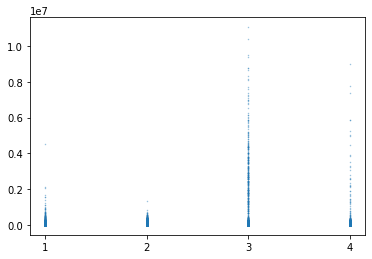

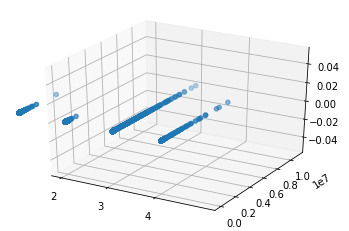

In [ ]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

column_names = combined_data.columns
total_all = [f_score,f_q_score,f_c_score,f_u_score]

transparency = 0.5
size = 0.2

plt.scatter(combined_data['Class'],combined_data['Combine'],s = size, alpha = transparency)
plt.show()


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(combined_data['Class'],combined_data['Combine'])
plt.show()

# PCA Analysis


## Dataset

Loading Library

In [ ]:
from sklearn import datasets
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder


Loading Dataset

In [ ]:
import matplotlib.cm
import matplotlib.colors
import matplotlib.pyplot as plt

# Encode the values in 'Class' as numerical values
encoder = LabelEncoder()
encoder.fit(combined_data['Class'])
combined_data['Class'] = encoder.transform(combined_data['Class'])

scaler = StandardScaler()
scaler.fit(combined_data)
x_standardized = scaler.transform(combined_data)
pca = PCA(n_components = 4)
pca.fit(x_standardized)

x_pca = pca.transform(x_standardized)
print(x_pca.shape)
print(x_pca)

content_df = pd.DataFrame(x_standardized,columns = ['PC1','PC2','PC3','PC4'])
content_df

# Map the values in 'Class' to colors
cmap = matplotlib.cm.get_cmap('viridis')
norm = matplotlib.colors.Normalize(vmin=combined_data['Class'].min(), vmax=combined_data['Class'].max())

# Create a scatter plot, coloring points based on 'Class'
plt.scatter(content_df['PC1'], content_df['PC2'],content_df['PC3'], c=cmap(norm(combined_data['Class'].values)), cmap=cmap)

# Add a colorbar and title to the plot
plt.colorbar()
plt.title('Combine of Time spend and Scores by each Contents')

# Show the plot
plt.show()

Scatter for Time columns and Contents

(231070, 2)
[[ 0.63309988 -1.28249326]
 [ 0.63309988 -1.28249326]
 [ 0.63309988 -1.28249326]
 ...
 [ 0.87717968  2.75662954]
 [-1.26442162  0.61502825]
 [-1.26442162  0.61502825]]


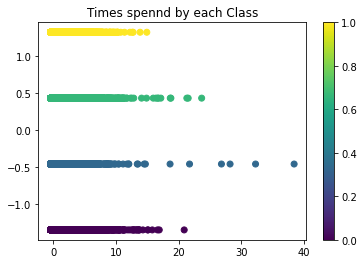

In [ ]:
from sklearn.preprocessing import LabelEncoder
import matplotlib.cm
import matplotlib.colors

# Encode the values in 'Class' as numerical values
encoder = LabelEncoder()
encoder.fit(combined_data1['Class'])
combined_data1['Class'] = encoder.transform(combined_data1['Class'])

scaler = StandardScaler()
scaler.fit(combined_data1)
x_standardized = scaler.transform(combined_data1)
pca = PCA(n_components = 2)
pca.fit(x_standardized)

x_pca = pca.transform(x_standardized)
print(x_pca.shape)
print(x_pca)

content_df = pd.DataFrame(x_standardized,columns = ['PC1','PC2'])
content_df
# Map the values in 'Class' to colors
cmap = matplotlib.cm.get_cmap('viridis')
norm = matplotlib.colors.Normalize(vmin=combined_data1['Class'].min(), vmax=combined_data1['Class'].max())

# Create a scatter plot, coloring points based on 'Class'
plt.scatter(content_df['PC1'], content_df['PC2'], c=cmap(norm(combined_data1['Class'].values)), cmap=cmap)

# Add a colorbar and title to the plot
plt.colorbar()
plt.title('Times spennd by each Class')

# Show the plot
plt.show()

## 2. Process PCA

In [ ]:
from sklearn.preprocessing import scale # Data scaling
from sklearn import decomposition #PCA
import pandas as pd # pandas

### 2.1 Load Dataset from arrays

In [ ]:
X = combine_ar
Y = array
Y

In [ ]:
X = scale(X)

### 2.2 PCA Analysis

In [ ]:
pca = decomposition.PCA(n_components=3)
pca.fit(X)

PCA(n_components=3)

### 2.3 Compute to retrieve the scores values

In [ ]:
scores = pca.transform(X)

In [ ]:
scores_df = pd.DataFrame(scores, columns=['PC1', 'PC2','PC3'])
scores_df

,PC1,PC2,PC3
0,-11159.517540,-26795.871322,0.238308
1,-11159.517540,-26795.871322,0.238308
2,-11159.517540,-26795.871322,0.238308
3,-11159.517540,-26795.871322,0.238308
4,-11159.517540,-26795.871322,0.238308
...,...,...,...
231065,-11159.517540,-26795.871322,0.238308
231066,-8709.145874,4117.164419,0.199056
231067,3221.975322,154636.035090,0.007931
231068,-11159.517540,-26795.871322,0.238308


In [ ]:
Y_label = []

for i in Y:
  if i == '1':
    Y_label.append('Space and Shape')
  elif i == '2':
    Y_label.append('Quantity')
  elif i == '3':
    Y_label.append('Change and Relationships')
  elif i == '4':
    Y_label.append('Uncertainty and Data')

Contents = pd.DataFrame(Y_label, columns=['Contents'])

In [ ]:
df_scores = pd.concat([scores_df, Contents], axis=1)
df_scores

### 2.4 Retreiving the loadings values

In [ ]:
loadings = pca.components_.T
df_loadings = pd.DataFrame(loadings, columns=['PC1', 'PC2','PC3'])
df_loadings

,PC1,PC2,PC3
0,0.079019,0.996873,-0.000001
1,0.000005,-0.000002,-1.000000
2,0.996873,-0.079019,0.000005


### 2.5 Explained varience for each PCA

In [ ]:
explained_variance = pca.explained_variance_ratio_
explained_variance

array([8.62903578e-01, 1.37096422e-01, 6.07449318e-11])

# **Scree** **Plot**

In [ ]:
import numpy as np
import plotly.express as px

### 3.1 Preparing explained variance and cumulative variance

#### 3.1.1 Preparing the explained variance data

In [ ]:
explained_variance

array([8.62903578e-01, 1.37096422e-01, 6.07449318e-11])

In [ ]:
explained_variance = np.insert(explained_variance, 0, 0)

#### 3.1.2 Preparing the cumulative variance data

In [ ]:
cumulative_variance = np.cumsum(np.round(explained_variance, decimals=3))

#### 3.1.3 Combining the dataframe

In [ ]:
pc_df = pd.DataFrame(['','PC1', 'PC2', 'PC3'], columns=['PC'])
explained_variance_df = pd.DataFrame(explained_variance, columns=['Explained Variance'])
cumulative_variance_df = pd.DataFrame(cumulative_variance, columns=['Cumulative Variance'])

In [ ]:
df_explained_variance = pd.concat([pc_df, explained_variance_df, cumulative_variance_df], axis=1)
df_explained_variance

,PC,Explained Variance,Cumulative Variance
0,,0.000000e+00,0.000
1,PC1,8.629036e-01,0.863
2,PC2,1.370964e-01,1.000
3,PC3,6.074493e-11,1.000


#### 3.1.4 Making the scree plot

#### 3.1.4.1 Explained Variance

In [ ]:
# https://plotly.com/python/bar-charts/

fig = px.bar(df_explained_variance,
             x='PC', y='Explained Variance',
             text='Explained Variance',
             width=800)

fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')
fig.show()

#### 3.1.4.1 Explained Variance and Cumulative Variance

In [ ]:
# https://plotly.com/python/creating-and-updating-figures/

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=df_explained_variance['PC'],
        y=df_explained_variance['Cumulative Variance'],
        marker=dict(size=15, color="LightSeaGreen")
    ))

fig.add_trace(
    go.Bar(
        x=df_explained_variance['PC'],
        y=df_explained_variance['Explained Variance'],
        marker=dict(color="RoyalBlue")
    ))

fig.show()

#### 3.1.4.1 Explained Variance and Cumulative Variance in separate

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Scatter(
        x=df_explained_variance['PC'],
        y=df_explained_variance['Cumulative Variance'],
        marker=dict(size=15, color="LightSeaGreen")
    ), row=1, col=1
    )

fig.add_trace(
    go.Bar(
        x=df_explained_variance['PC'],
        y=df_explained_variance['Explained Variance'],
        marker=dict(color="RoyalBlue"),
    ), row=1, col=2
    )

fig.show()

### **Scores Plot**

In [ ]:
import plotly.express as px

#### 4.1 Basic 3D Scatter Plot

In [ ]:
fig = px.scatter_3d(df_scores, x='PC1', y='PC2', z='PC3',
              color='Contents')

fig.show()

#### 4.2 Customized 3D Scatter Plot

In [ ]:
fig = px.scatter_3d(df_scores, x='PC1', y='PC2', z='PC3',
              color='Contents',
              symbol='Contents',
              opacity=0.5)


fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

